# Modules

In [ ]:
# Import and mount to access drive
from google.colab import drive
drive.mount('/gdrive')

Mounted at /gdrive


In [ ]:
# Python Image Library
from PIL import Image

In [ ]:
import numpy as np

import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
import plotly.graph_objects as go

import random

In [ ]:
# Import KMeans module
from sklearn.cluster import KMeans

# Image Compression using K-means

## Data Visualisation

In [ ]:
# Open an image file
image = Image.open('/gdrive/MyDrive/test.png')

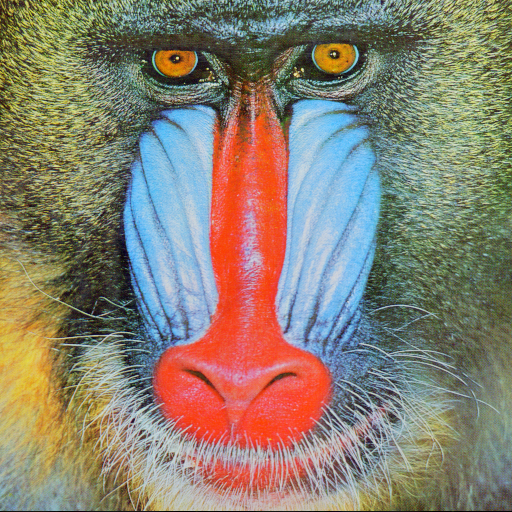

In [ ]:
# Display the image
image

In [ ]:
# Pixels size
print(image.size)

(512, 512)


In [ ]:
# Converting image into an array for easier operations
image_np = np.array(image)
print(image_np.shape)

(512, 512, 3)


In [ ]:
# Converting 3D data to 2D
image_reshaped = image_np.reshape(-1, 3)
# -1 here is replaced by required dimension after calculation automatically
print(image_reshaped.shape)

(262144, 3)


In [ ]:
# Extracting RGB values
r = image_reshaped[:, 0]
g = image_reshaped[:, 1]
b = image_reshaped[:, 2]

# Create a 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=r,
    y=g,
    z=b,
    mode='markers',
    marker=dict(
        size=5,
        color=image_reshaped/255,  # Normalize RGB values to [0, 1]
        opacity=0.8
    )
)])

# Update layout
fig.update_layout(
    scene=dict(
        xaxis=dict(title='Red'),
        yaxis=dict(title='Green'),
        zaxis=dict(title='Blue')
    ),
    title='Pixel Values in RGB Color Space'
)

# Show plot
fig.show()

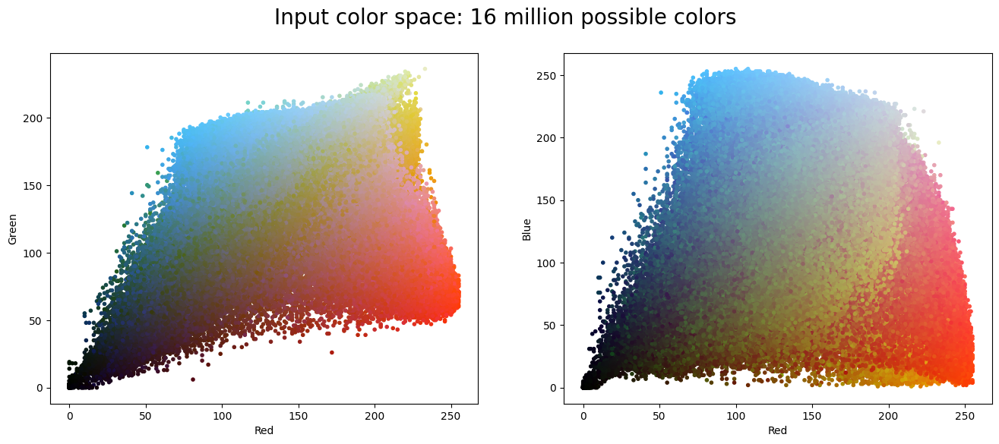

In [ ]:
# Create a figure with two subplots side by side
fig, ax = plt.subplots(1, 2, figsize=(16, 6))

# Plotting the scatter plot of red vs green in the left subplot (ax[0])
ax[0].scatter(r, g, color=image_reshaped/255, marker='.')
ax[0].set(xlabel='Red', ylabel='Green')  # Setting labels for x and y axes

# Plotting the scatter plot of red vs blue in the right subplot (ax[1])
ax[1].scatter(r, b, color=image_reshaped/255, marker='.')
ax[1].set(xlabel='Red', ylabel='Blue')  # Setting labels for x and y axes

# Adding a title to the overall figure
fig.suptitle('Input color space: 16 million possible colors', size=20);

## Task a

In [ ]:
def computeCentroid(data):
    return np.mean(data, axis = 0)

## Task b

In [ ]:
def mykmeans(data_matrix, k):
    # Initialize the k-means of cluster
    means = []
    means.append(random.choice(image_reshaped)) # Randomly taking one of the point as mean

    while len(means) < k: # Iterating till required number of means are found
        distances = np.array([min([np.linalg.norm(x-c)**2 for c in means]) for x in image_reshaped])
        probabilities = distances / distances.sum()
        cumulative_probabilities = probabilities.cumsum()
        r = random.random() # Based on r we keep choosing another point as next mean
        for j, p in enumerate(cumulative_probabilities):
            if r < p:
                means.append(data_matrix[j])
                break

    labels = [[] for _ in range(k)] # This list organises the clusters

    while True:
        # Assign each data point to the nearest mean
        for i in data_matrix:
            distances = [np.linalg.norm(i - mean) for mean in means]
            label = np.argmin(distances)
            labels[label].append(i)

        # Update means
        new_means = [computeCentroid(cluster) for cluster in labels]

        # Check for convergence
        if np.array_equal(means, new_means):
            break

        means = new_means # If means are updated keep repeating the process
        labels = [[] for _ in range(k)]

    return means

## Task c

In [ ]:
def compressed_image(k):

    # Get centroid means
    means = mykmeans(image_reshaped, k)
    new_image = []

    for i in image_reshaped:
        distances = [np.linalg.norm(i - mean) for mean in means]
        label = np.argmin(distances)
        new_image.append(means[label]) # Replace the point which centroid/mean

    new_image = np.array(new_image)
    return new_image

In [ ]:
# k = 2
new_image = compressed_image(2)

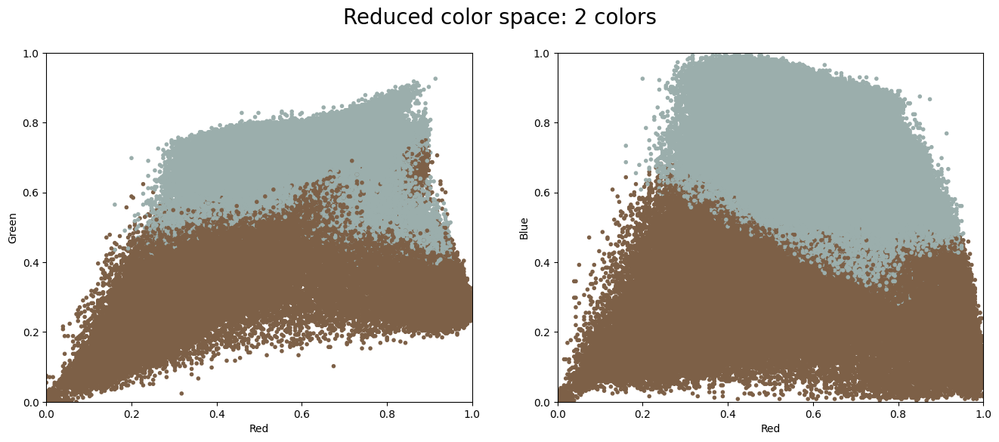

In [ ]:
r, g, b = image_reshaped.T / 255
fig, ax = plt.subplots(1, 2, figsize=(16, 6))
ax[0].scatter(r, g, c=new_image/255, marker='.')
ax[0].set(xlabel='Red', ylabel='Green', xlim=(0, 1), ylim=(0, 1))

ax[1].scatter(r, b, c=new_image/255, marker='.')
ax[1].set(xlabel='Red', ylabel='Blue', xlim=(0, 1), ylim=(0, 1))

fig.suptitle('Reduced color space: 2 colors', size=20);

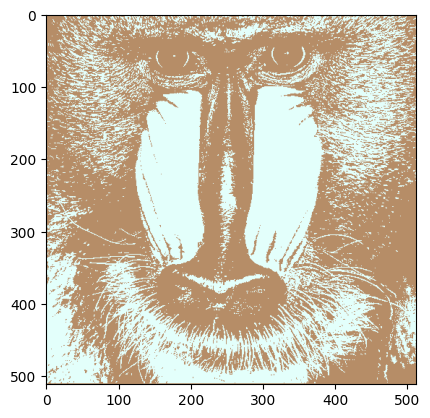

In [ ]:
new_image = new_image.reshape(512, 512, 3)
new_image_normalized = new_image / np.max(new_image)
plt.imshow(new_image_normalized)

In [ ]:
# k = 6
new_image = compressed_image(6)

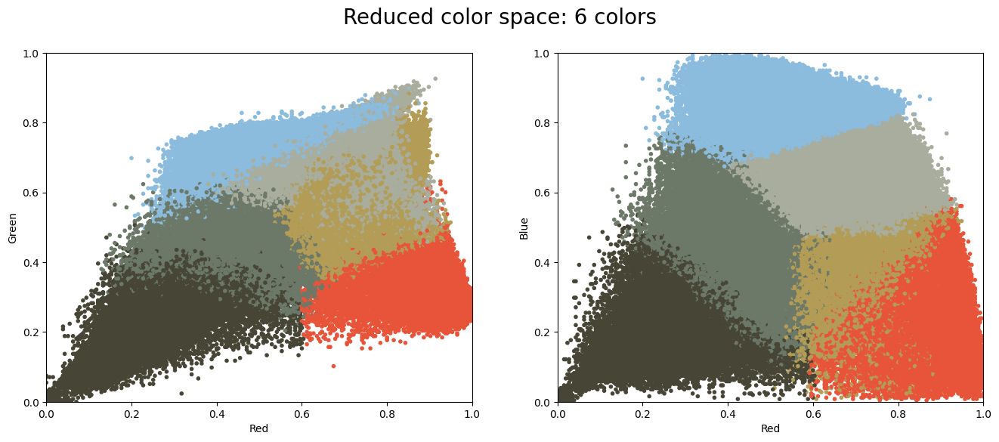

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(16, 6))
ax[0].scatter(r, g, color=new_image/255, marker='.')
ax[0].set(xlabel='Red', ylabel='Green', xlim=(0, 1), ylim=(0, 1))

ax[1].scatter(r, b, color=new_image/255, marker='.')
ax[1].set(xlabel='Red', ylabel='Blue', xlim=(0, 1), ylim=(0, 1))

fig.suptitle('Reduced color space: 6 colors', size=20);

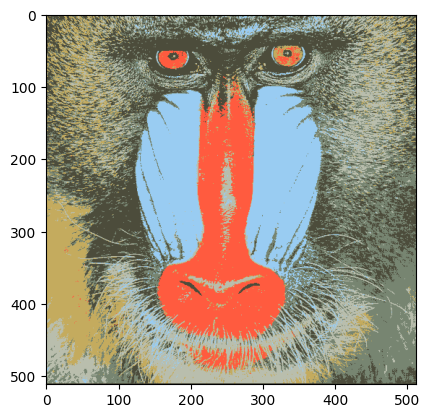

In [ ]:
new_image = new_image.reshape(512, 512, 3)
new_image_normalized = new_image / np.max(new_image)
plt.imshow(new_image_normalized)

In [ ]:
# k = 10
new_image = compressed_image(10)

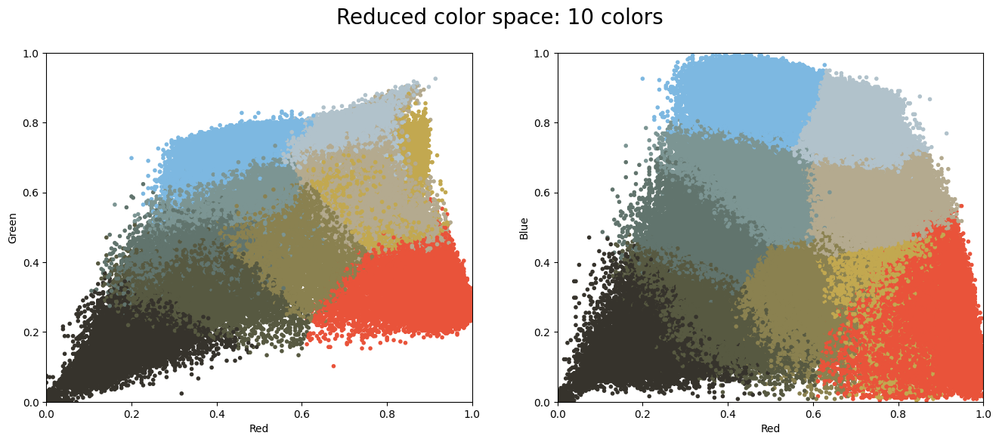

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(16, 6))
ax[0].scatter(r, g, color=new_image/255, marker='.')
ax[0].set(xlabel='Red', ylabel='Green', xlim=(0, 1), ylim=(0, 1))

ax[1].scatter(r, b, color=new_image/255, marker='.')
ax[1].set(xlabel='Red', ylabel='Blue', xlim=(0, 1), ylim=(0, 1))

fig.suptitle('Reduced color space: 10 colors', size=20);

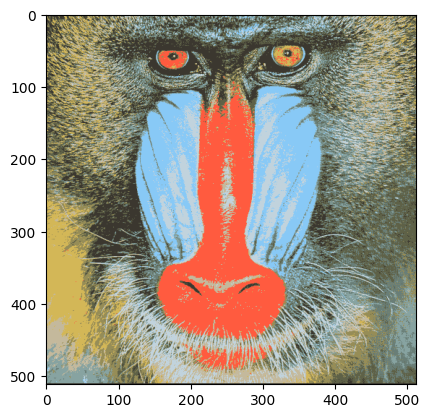

In [ ]:
new_image = new_image.reshape(512, 512, 3)
new_image_normalized = new_image / np.max(new_image)
plt.imshow(new_image_normalized)

## Task d

In [ ]:
def compressed_image(k):

    # Get centroid means
    means = KMeans(init="k-means++", n_clusters=k, n_init=1,
                  random_state=0).fit(image_reshaped).cluster_centers_
    new_image = []

    for i in image_reshaped:
        distances = [np.linalg.norm(i - mean) for mean in means]
        label = np.argmin(distances)
        new_image.append(means[label]) # Replace the point which centroid/mean

    new_image = np.array(new_image)
    return new_image

In [ ]:
# k = 2
new_image = compressed_image(2)

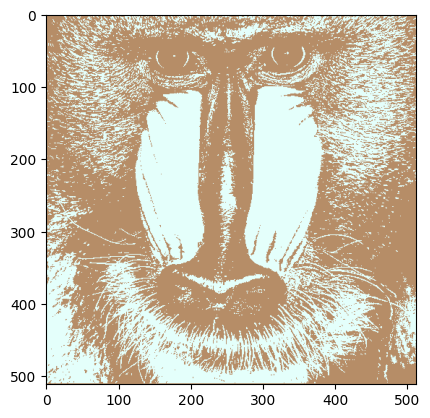

In [ ]:
new_image = new_image.reshape(512, 512, 3)
new_image_normalized = new_image / np.max(new_image)
plt.imshow(new_image_normalized)

In [ ]:
# k = 6
new_image = compressed_image(6)

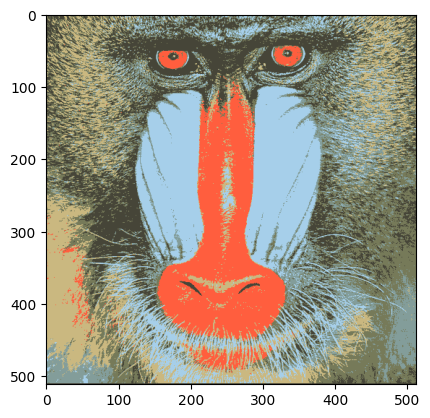

In [ ]:
new_image = new_image.reshape(512, 512, 3)
new_image_normalized = new_image / np.max(new_image)
plt.imshow(new_image_normalized)

In [ ]:
# k = 10
new_image = compressed_image(10)

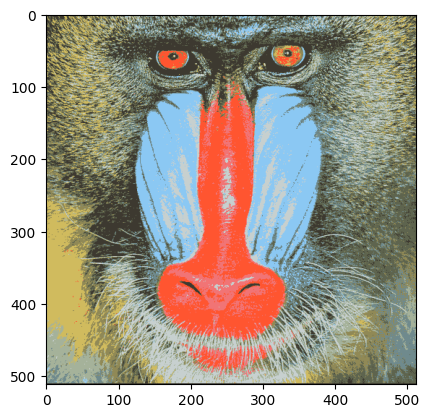

In [ ]:
new_image = new_image.reshape(512, 512, 3)
new_image_normalized = new_image / np.max(new_image)
plt.imshow(new_image_normalized)

## Task e

In [ ]:
d = KMeans(init="k-means++", n_clusters=10, n_init=1,
                  random_state=0).fit(image_reshaped).labels_

In [ ]:
block = d.reshape(512, 512)

In [ ]:
block

array([[8, 5, 5, ..., 3, 6, 8],
       [3, 3, 5, ..., 3, 6, 3],
       [9, 3, 5, ..., 9, 9, 9],
       ...,
       [2, 6, 2, ..., 9, 9, 9],
       [6, 2, 2, ..., 9, 9, 9],
       [5, 5, 5, ..., 5, 5, 5]], dtype=int32)

In [ ]:
block.shape

(512, 512)

In [ ]:
e = new_image.reshape(-1, 3)

In [ ]:
colors = []
for i in range(10):
  colors.append(e[np.where(d == i)[0][0]])

In [ ]:
final = np.zeros((512, 512))

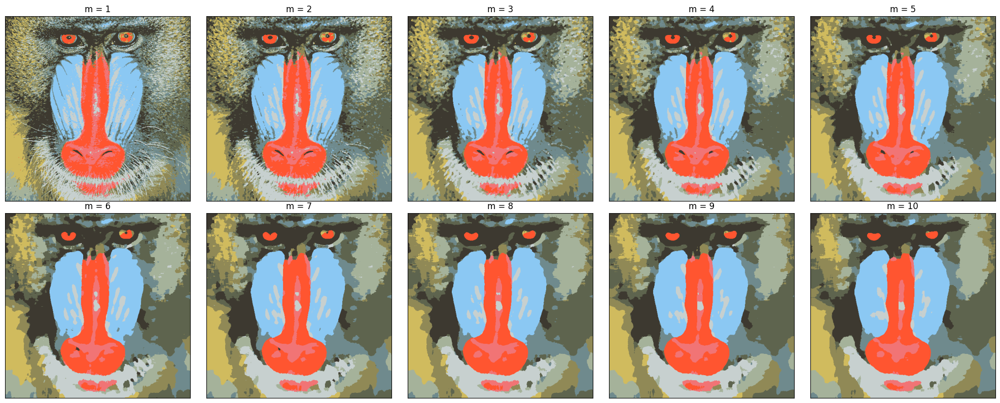

In [ ]:
fig, axs = plt.subplots(2, 5, figsize=(20, 8))

for m, ax in zip(range(1, 11), axs.flatten()):
    final = np.zeros((512, 512))
    for i in range(512):
        for j in range(512):
            l = i
            r = j
            l1 = l - m
            r1 = r - m
            if l1 < 0:
                l1 = 0
            if r1 < 0:
                r1 = 0
            l2 = l + m
            r2 = r + m
            if l2 > 511:
                l2 = 511
            if r2 > 511:
                r2 = 511
            chotu = block[l1:l2, r1:r2]
            unique, counts = np.unique(chotu, return_counts=True)
            final[i][j] = unique[np.argmax(counts)]

    final_image = np.zeros((512, 512, 3))

    for i in range(512):
        for j in range(512):
            final_image[i][j] = colors[int(final[i][j])].tolist()

    final_image = final_image.reshape(512, 512, 3)
    new_image_normalized = final_image / np.max(final_image)
    ax.imshow(new_image_normalized)
    ax.set_title(f"m = {m}")
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.show()

In [ ]:
bb = block[150:160, 130:140]
fi = np.zeros((9, 9, 3))
for i in range(9):
        for j in range(9):
            fi[i][j] = colors[bb[i][j]].tolist()

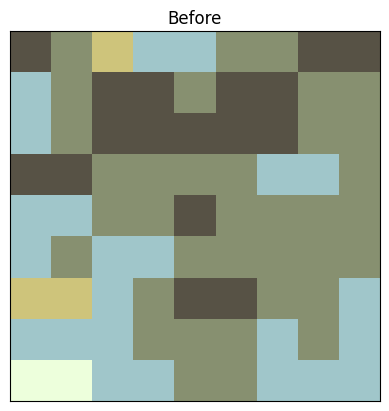

In [ ]:
# Before
fi_norm = fi / np.max(fi)
plt.xticks([])
plt.yticks([])
plt.title("Before")
plt.imshow(fi_norm)

In [ ]:
ex = new_image_normalized[150:160, 130:140, :]

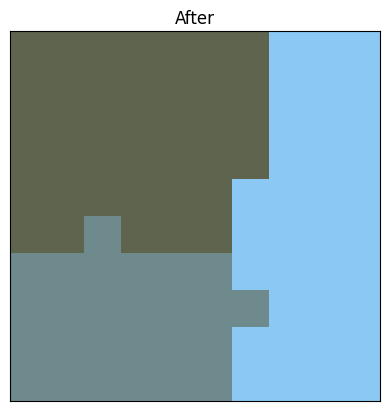

In [ ]:
# After
plt.xticks([])
plt.yticks([])
plt.title("After")
plt.imshow(ex)